# <h1 style="text-align: center;"> Figure plotting notebook </h1>

This Python notebook loads MHWs netCDF files and produces figures.

## Setup

Run this script only once to setup all the necessary modules to generate the figures.

In [1]:
# Enables modules autoreload (important during development)
%load_ext autoreload
%autoreload 2

# Basic imports
import os

import numpy as np
import xarray as xr
import matplotlib.pyplot as plt

import pymannkendall as mk

import pyscripts.options as opts
import pyscripts.utils as utils

# Define basic paths that may be useful
root_path = os.path.join(os.path.abspath(os.getcwd()), '..')
print(root_path)

/LOCALDATA/ARTHURs_FILES/Codigos/..


In [2]:
from pyscripts.load_save_dataset import load_mhws_dataset, load_bathy

# Load the two MHW annual metrics dataset that were computed with REP and MEDREA respectively
ds_mhws_rep = load_mhws_dataset("yearly", "rep", False, "balears", (1987,2021))
ds_mhws_medrea = load_mhws_dataset("yearly", "medrea", False, "balears", (1987,2021))

# Load the MEDREA bathymetry dataset
ds_bathy_medrea = load_bathy(source="MEDREA")

# Interpolate bathymetry data onto REP grid
ds_bathy_rep = ds_bathy_medrea.interp(
    lat=ds_mhws_rep.lat,
    lon=ds_mhws_rep.lon,
    method="linear"
)

Loaded MHWs dataset.
Loaded MHWs dataset.
Loaded MEDREA bathymetry dataset.


In [3]:
# Basic options
clim_period = (1987, 2021)
subplot_label = [chr(ord('a')+n) + ')' for n in range(26)]

## Figure 1

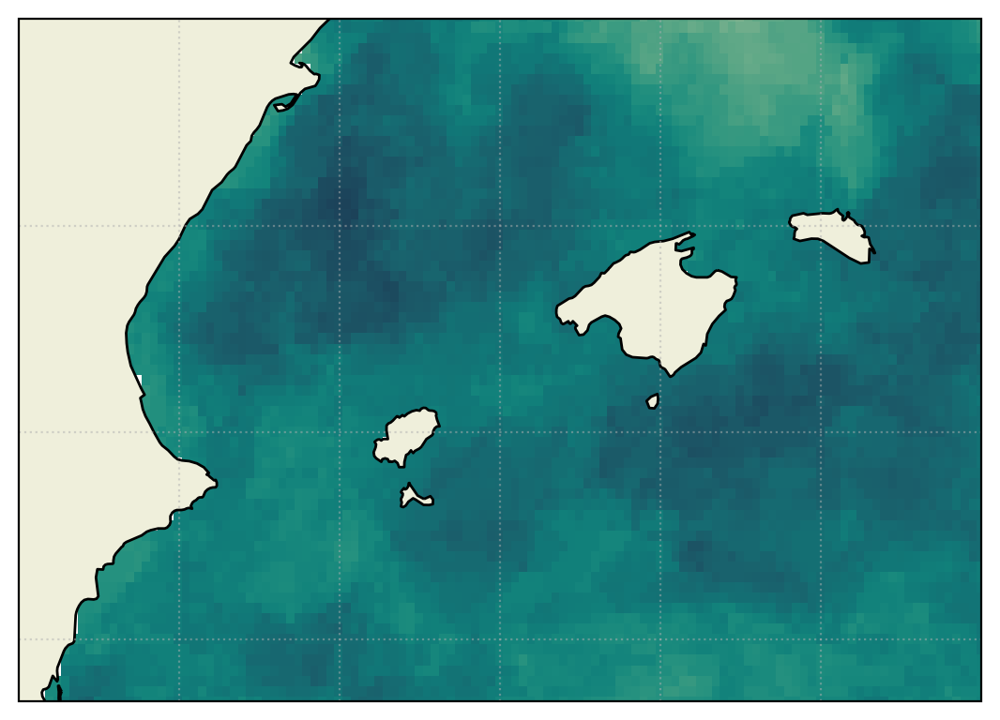

In [7]:
from pyscripts.basic_plotter import plot_map

da = ds_mhws_rep.total_days.sel(year=2022)

plot_map(
    da.lon, da.lat,
    da,
    
    figsize=(12,4),
    fontsize=12,
    figdpi=200,

    add_cbar=False,
    cmap='cmo.tempo',
    vmin=20, vmax=250,
    yticks=4,
    bottom_labels=False,
    left_labels=False,

    show_plots=True,
)

## Figure 2

In [8]:
from pyscripts.load_save_dataset import load_mhws_dataset

# Loads the region-averaged mhw dataset
ds_mhws_rep_mean = load_mhws_dataset(
    ds_type = 'all_events',
    dataset_used = 'rep_mean',
    detrended = False,
    region = 'balears',
    clim_period = clim_period
)

Loaded MHWs dataset.


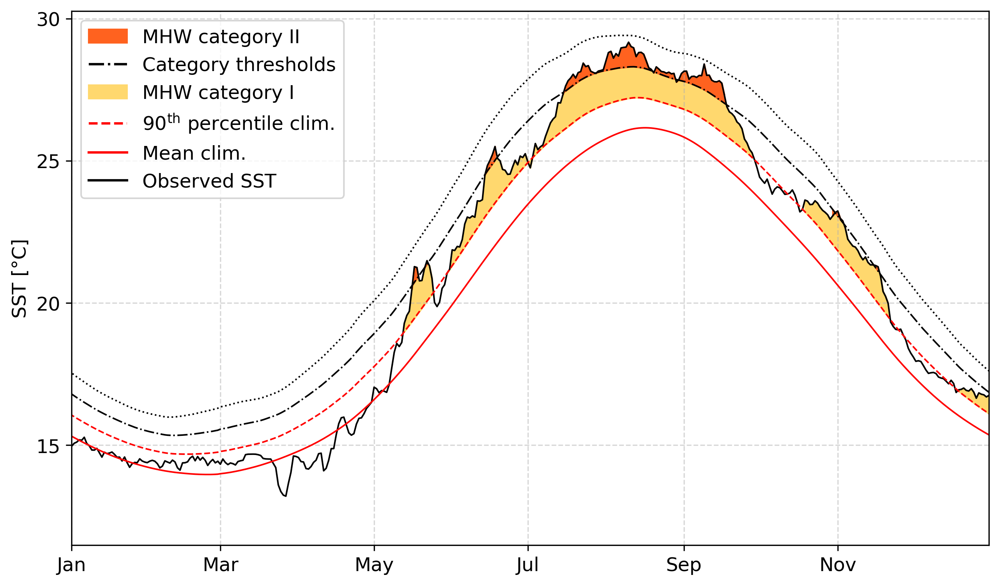

In [9]:
from pyscripts.mhw_computer import get_mhw_ts_from_ds
import matplotlib.pyplot as plt
import numpy as np

from datetime import date
from matplotlib.lines import Line2D
from matplotlib.patches import Patch
import scipy.ndimage as ndimage

from pyscripts.basic_plotter import get_locator_from_ticks


yticks = (5,0)
yticks_minor = (2.5,)


# Code
max_thr = 2

with plt.rc_context({'font.size': 12}):
    fig = plt.figure(figsize=(8.6, 5), dpi=300, constrained_layout=True)

    time, mhws = get_mhw_ts_from_ds(ds_mhws_rep_mean, None, None, None)
    
    ax = fig.add_subplot(1, 1, 1)

    # ax.plot(time, mhws["clim_sst"], label="REP-SST", c='k', lw=1, marker='x', markersize=3)
    ax.plot(time, mhws["clim_sst"], label="REP-SST", c='k', lw=1)
    ax.plot(time, mhws["clim_thresh"], label="1987-2021 p90", c='r', ls='--', lw=1)
    ax.plot(time, mhws["clim_seas"], label="1987-2021 mean", c='r', lw=1)


    colors = { 1: '#ffd86e', 2: '#ff621f', 3: '#df391b', 4: '#861a15'}
    lss = { 1: '--', 2: '-.', 3: ':', 4: '..'}


    for i in range(2, max_thr+2):
        mhws[f"clim_{i}thresh"] = mhws["clim_thresh"]*i - mhws["clim_seas"]*(i-1)
        ax.plot(time, mhws[f"clim_{i}thresh"], c="k", alpha=1, ls=lss[i], lw=1) 


    for ev in range(mhws["n_events"]):
        id_slice = slice(mhws["index_start"][ev], mhws["index_end"][ev]+1)
        temp = mhws["clim_sst"][id_slice]
        
        ax.fill_between(
            time[id_slice],
            mhws["clim_thresh"][id_slice],
            np.minimum(
                mhws["clim_sst"][id_slice],
                mhws["clim_2thresh"][id_slice],
            ),
            color='#ffd86e',
        )

        for i in range(2, max_thr+1):
            lower_thr = mhws[f"clim_{i}thresh"][id_slice]
            upper_thr = mhws[f"clim_{i+1}thresh"][id_slice]
            times = time[id_slice]

            exceed_bool = temp - lower_thr
            # exceed_bool[exceed_bool<=0] = False
            # exceed_bool[exceed_bool>0] = True
            exceed_bool = exceed_bool>=0

            events, n_events = ndimage.label(exceed_bool)
            
            for ev_ in range(1,n_events+1):
                slice_ = slice(np.where(events == ev_)[0][0]-1, np.where(events == ev_)[0][-1]+1)

                if times[np.where(events == ev_)[0][0]].astype('datetime64[Y]').astype(int) + 1970 == 2022 and times[np.where(events == ev_)[0][0]].astype('datetime64[M]').astype(int) % 12 + 1 == 12:
                    print(f"Filling Cat {i} from {times[np.where(events == ev_)[0][0]]} to {times[np.where(events == ev_)[0][-1]]}")

                ax.fill_between(
                    times[slice_],
                    lower_thr[slice_],
                    np.minimum(
                        temp[slice_],
                        upper_thr[slice_],
                    ),
                    color=colors[i],
                )

    ax.grid(ls='--', alpha=0.5)
    ax.grid(which='minor', ls='--', alpha=0.3)
    ax.set_ylabel("SST [°C]")

    ax.set_xlim(date(2022, 1, 1), date(2022, 12, 31))
    
    ax.set_xticks(
        [date(2022, mm, 1) for mm in range(1, 13, 2)],
        ['Jan', 'Mar', 'May', 'Jul', 'Sep', 'Nov'],
    )
    # ax.set_xticks(
    #     [date(2022, mm, 1) for mm in range(1, 13)],
    #     minor=True
    # )
    # ax.xaxis.set_major_locator(get_locator_from_ticks(xticks))
    # ax.xaxis.set_minor_locator(get_locator_from_ticks(xticks_minor))

    # ax.set_ylim(12, 18)
    ax.yaxis.set_major_locator(get_locator_from_ticks(yticks))
    # ax.yaxis.set_minor_locator(get_locator_from_ticks(yticks_minor, which='minor'))
    

    # ax.set_title(f"{depth:.0f}m")
    ax.get_legend_handles_labels()

    ax.legend(
        [
            Patch(color='#ff621f'),
            Line2D([0], [0], c='k', ls='-.'),
            Patch(color='#ffd86e'),
            Line2D([0], [0], c='r', ls='--'),
            Line2D([0], [0], c='r'),
            Line2D([0], [0], color='k'),
        ], ["MHW category II", "Category thresholds", "MHW category I", "90$\mathregular{^{th}}$ percentile clim.", "Mean clim.", "Observed SST"],
        # ], ["MHW category II", "Multiples of 90$\mathregular{^{th}}$ percentile", "MHW category I", "90$\mathregular{^{th}}$ percentile clim.", "Mean clim.", "Observed SST"],
        # fontsize=10,
        loc='upper left',
    )

plt.show()


## Figure 3

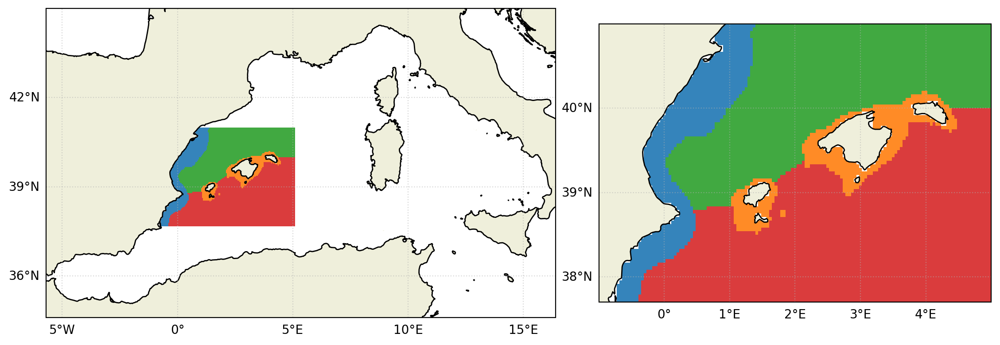

In [10]:
from pyscripts.basic_plotter import plot_map

from pyscripts.utils import apply_regional_mask
import cartopy.crs as ccrs

from matplotlib.colors import ListedColormap

# Compute regional masks
da_regions = xr.full_like(ds_mhws_medrea.isel(depth=0, year=0).total_days, np.nan)

continental_coast_mask = apply_regional_mask(da_regions, 'continental_coast', ds_bathy_medrea, return_mask=True)
balearic_coast_mask = apply_regional_mask(da_regions, 'balearic_coast', ds_bathy_medrea, return_mask=True)
balearic_sea_deep_mask = apply_regional_mask(da_regions, 'balearic_sea_deep', ds_bathy_medrea, return_mask=True)
west_algerian_deep_mask = apply_regional_mask(da_regions, 'west_algerian_deep', ds_bathy_medrea, return_mask=True)

da_regions = da_regions.where(~continental_coast_mask, other=1) # Continental coast
da_regions = da_regions.where(~balearic_coast_mask, other=2) # Balearic coast
da_regions = da_regions.where(~balearic_sea_deep_mask, other=3) # Balearic Sea deep
da_regions = da_regions.where(~west_algerian_deep_mask, other=4) # West Algerian deep

# Generate color map
alpha = 0.9
cmap = ListedColormap([('C0', alpha), ('C1', alpha), ('C2', alpha), ('C3', alpha)])

# Plot
fig, ax = plot_map(
    da_regions.lon, da_regions.lat,
    da_regions,

    figsize=(12,4),
    fontsize=12,
    figdpi=200,

    extent=[-5.7,16.4,34.6,45],

    add_cbar=False,
    cmap=cmap,
    vmin=1, vmax=4,
    yticks=4,
    xticks=5,

    # show_plots=True,
)

x1, x2, y1, y2 = -1, 5, 37.7, 41  # subregion of the original image
axins = ax.inset_axes(
    [1.02, 0.05, 0.9, 0.9],
    xlim=(x1, x2), ylim=(y1, y2), xticklabels=[], yticklabels=[], projection=ccrs.PlateCarree()
)

plot_map(
    da_regions.lon, da_regions.lat,
    da_regions,

    fig=fig, ax=axins,
    figsize=(8,20),
    fontsize=12,
    figdpi=200,

    extent=None,

    add_cbar=False,
    cmap=cmap,
    vmin=1, vmax=4,
    yticks=4,
)

plt.show()

## Figure 4

Making figure of 2400x1080.0px


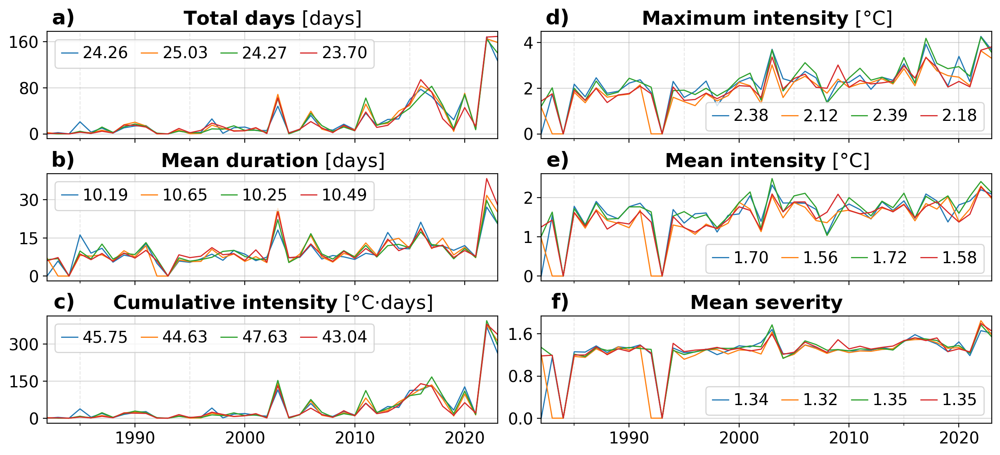

In [ ]:
from pyscripts.basic_plotter import plot_timeserie, subplot
from pyscripts.utils import apply_regional_mask

import math

stats = [
    'total_days',
    'duration',
    'total_icum',
    'intensity_max_max',
    'intensity_mean_byday',
    'severity_mean_byday',
]
regions = [
    "continental_coast",
    "balearic_coast",
    "balearic_sea_deep",
    "west_algerian_deep",
]

ncols = 2
nrows = math.ceil(len(stats) / ncols)


regions_ds = {}

for region in regions:
    regions_ds[region] = apply_regional_mask(ds_mhws_rep, region, ds_bathy_rep)


subplots_settings = []

for id, stat in enumerate(stats):
    col = id // nrows
    row = id % nrows
    # col = id % ncols
    # row = id // ncols

    escaped_name = opts.mhws_stats_shortname[stat].replace(' ', '\ ')

    subplots_settings.append(dict(
        pos = row * ncols + col + 1,
        func = plot_timeserie,
        vars = {
            opts.region_shortname[region]:
                regions_ds[region][stat].mean(dim=["lon","lat"])
            
            for region in regions
        },
        times = regions_ds[regions[0]].year,
        colors = {
            "Continental coast": 'C0',
            "Balearic Islands coast": 'C1',
            "Balearic Sea deep": 'C2',
            "West Algerian Basin deep": 'C3',
        },

        nans_to_zero = True,

        title = fr"$\bf{{{escaped_name}}}${f' [{opts.mhws_stats_units[stat]}]' if stat != 'severity_mean_byday' else ''}",
        legend = {
            'labels': [
                f"{regions_ds[region][stat].mean(dim=['lon','lat']).mean(dim='year'):.2f}"
                for region in regions
            ],
            'ncol': 4,
            'loc': 4 if stat in ['intensity_max_max', 'intensity_mean_byday', 'severity_mean_byday'] else None,
            'handletextpad': 0.3,
            'columnspacing': 0.8,
            'handlelength': 1,
        },

        xticks=(10,),
        xticks_minor=2,

        yticks=3,

        bottom_labels = row == nrows-1,
        # ylabel = f"[{opts.mhws_stats_units[stat]}]",
        texts = [dict(
            x=0.06,
            y=1.03,
            s=utils.bold(subplot_label[row + nrows*col]),
            ha='right',
            va='bottom',
            fontsize=18
        )]
    ))

subplot(
    nrows, ncols,
    subplots_settings,

    # figsize = (12, 4.4),
    figsize = (12, 5.4),
    figdpi = 200,
    fig_fontsize = 14,

    show_plots = True,
)

## Table 2

In [7]:
from scipy.stats import theilslopes

for i, stat in enumerate([
    'total_days',
    'duration',
    'total_icum',
    'intensity_max_max',
    'intensity_mean_byday',
    'severity_mean_byday',
]):
    print(f"{i+1}. {opts.mhws_stats_shortname[stat]}")

    for model in ["REP82", "REP", "MEDREA"]:
        if model == "REP82":
            da = ds_mhws_rep[stat].sel(year=slice(1982,2023))
        elif model == "REP":
            da = ds_mhws_rep[stat].sel(year=slice(1987,2022))
        elif model == "MEDREA":
            da = ds_mhws_medrea[stat].sel(depth=0, method='nearest')

        y = da.mean(dim=["lon", "lat"])

        mean = y.mean(dim='year')
        std = y.std(dim='year')

        trend, h, p, z, tau, s, var_s, slope, intercept = mk.hamed_rao_modification_test(y, alpha=0.05)
        slope_, intercept_, lower, upper = theilslopes(y, alpha=0.05)

        print(f"{model} mean : {mean:.2f} ± {std:.2f} {opts.mhws_stats_units[stat]}")

        if h:
            print(f"{model} trend : {slope*10:.2f} ± {(upper-lower)/2 * 10:.2f} {opts.mhws_stats_units[stat]} /decade (p-value={p:.5f})")
        
        else:
            print(f"No significant trend for {model}.")

    
    print()

1. Total days
REP82 mean : 24.04 ± 36.56 days
REP82 trend : 8.49 ± 5.57 days /decade (p-value=0.00000)
REP mean : 23.57 ± 32.06 days
REP trend : 8.36 ± 6.30 days /decade (p-value=0.00046)
MEDREA mean : 30.64 ± 37.89 days
MEDREA trend : 12.26 ± 9.14 days /decade (p-value=0.00003)

2. Mean duration
REP82 mean : 10.48 ± 5.50 days
REP82 trend : 1.07 ± 1.05 days /decade (p-value=0.00218)
REP mean : 10.38 ± 5.28 days
REP trend : 0.98 ± 1.04 days /decade (p-value=0.01986)
MEDREA mean : 12.74 ± 7.35 days
No significant trend for MEDREA.

3. Cumulative intensity
REP82 mean : 45.10 ± 77.47 °C·days
REP82 trend : 15.00 ± 10.04 °C·days /decade (p-value=0.00000)
REP mean : 43.56 ± 69.04 °C·days
REP trend : 15.02 ± 11.73 °C·days /decade (p-value=0.00028)
MEDREA mean : 51.16 ± 74.85 °C·days
MEDREA trend : 19.93 ± 13.02 °C·days /decade (p-value=0.00014)

4. Maximum intensity
REP82 mean : 2.28 ± 0.62 °C
REP82 trend : 0.30 ± 0.15 °C /decade (p-value=0.00000)
REP mean : 2.31 ± 0.57 °C
REP trend : 0.28 ± 0

## Figure 5

In [9]:
def apply_mk_test(y):
    if np.isnan(y).all():
        return np.nan, np.nan, np.nan
    
    trend, h, p, z, tau, s, var_s, slope, intercept = mk.hamed_rao_modification_test(y, alpha=0.05)
    
    return h, p, slope

h, p, slope = xr.apply_ufunc(
    apply_mk_test,
    ds_mhws_rep[opts.mhws_basic_stats],
    input_core_dims = [["year"]],
    output_core_dims = [[], [], []],
    vectorize = True,
    dask = "parallelized",
    output_dtypes = [bool, float, float],
)

ds_trend = slope.where(h) * 10

/home/arthur/.local/lib/python3.10/site-packages/pymannkendall/pymannkendall.py:99: RuntimeWarning: invalid value encountered in sqrt
  z = (s - 1)/np.sqrt(var_s)
/home/arthur/.local/lib/python3.10/site-packages/pymannkendall/pymannkendall.py:103: RuntimeWarning: invalid value encountered in sqrt
  z = (s + 1)/np.sqrt(var_s)


Making figure of 2400x3200px


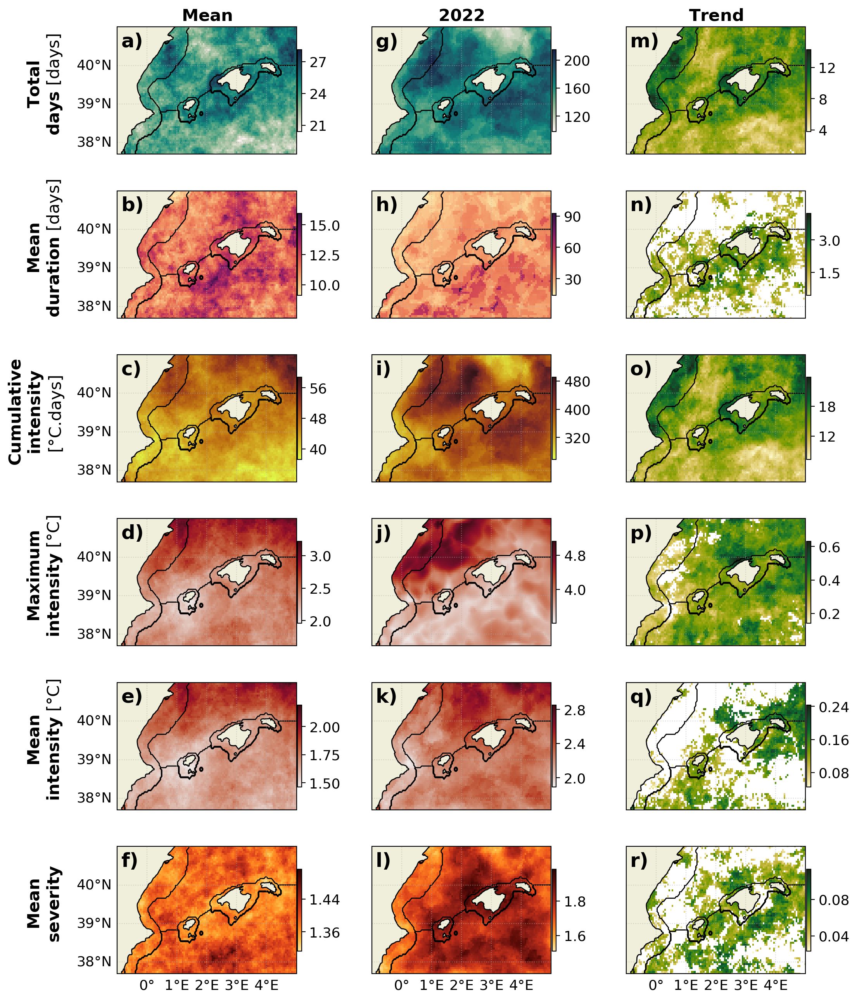

In [ ]:
from pyscripts.basic_plotter import plot_map, subplot

columns = ['Mean', '2022', 'Trend']
stats = [
    'total_days',
    'duration',
    'total_icum',
    'intensity_max_max',
    'intensity_mean_byday',
    'severity_mean_byday',
]

vlims = {
    'total_days': (98.00, 215.00),
    'duration': (14.10, 92.50),
    'total_icum': (258.51, 490.28),
    'intensity_max_max': (3.21, 5.13),
    'intensity_mean_byday': (1.89, 2.85),
    'severity_mean_byday': (1.51, 1.98),
}
names = {
    "total_days":           r"$\bf{Total}$" "\n" r"$\bf{days}$ [days]",
    "duration":             r"$\bf{Mean}$" "\n" r"$\bf{duration}$ [days]",
    "total_icum":           r"$\bf{Cumulative}$" "\n" r"$\bf{intensity}$" "\n[°C.days]",
    "intensity_max_max":    r"$\bf{Maximum}$" "\n" r"$\bf{intensity}$ [°C]",
    "intensity_mean_byday": r"$\bf{Mean}$" "\n" r"$\bf{intensity}$ [°C]",
    "severity_mean_byday": r"$\bf{Mean}$" "\n" r"$\bf{severity}$",
}

ncols = len(columns)
nrows = len(stats)

subplots_settings = []

for iss, stat in enumerate(stats):
    for ic, column in enumerate(columns):
        row = iss
        col = ic

        cmap=opts.mhws_stats_cmaps[stat]

        if column == 'Mean':
            da = ds_mhws_rep[stat].mean(dim='year')

            # print("Period-averaged ranges: \n" if iss == 0 else '', end='')
            # print(f"{stat}: {da.min().item():.2f}, {da.max().item():.2f}")
        
        elif column == '2022':
            da = ds_mhws_rep[stat].sel(year=2022)

        elif column == 'Trend':
            da = ds_trend[stat]
            cmap = 'cmo.speed'


        subplots_settings.append(dict(
            pos = iss*ncols + ic + 1,
            func = plot_map,
            lon = da.lon,
            lat = da.lat,
            data = da,
            title = r"$\bf{" + column.replace(' ', ' \ ') + "}$" if row == 0 else None,
            # ylabel = names[stat] if col == 0 else None,
            ylabel = names[stat] if col == 0 else None,

            fontsize_title=1.2,
            ylabel_pad = -0.3,

            cmap=cmap,
            cbar_shrink=0.6,
            
            xticks = 6,
            yticks = 4,
            cbar_ticks=3,

            contours_levels=[2.5, 3.5],
            contours_data = [
                da_regions.lon,
                da_regions.lat,
                da_regions
            ],
            contours_kwargs=dict(
                colors='k', linewidths=1, zorder=-1
            ),

            left_labels = (col == 0),
            bottom_labels = (row == nrows - 1),

            texts = [dict(
                x=0.02,
                y=0.96,
                s=utils.bold(subplot_label[row + nrows*col]),
                ha='left',
                va='top',
                fontsize=18
            )]
        ))

# Creates figure settings, using user settings firstly, otherwise use default
subplot(
    nrows, ncols,
    subplots_settings,
    pad_subplots=(None, 0.2),
    
    figsize = (12,16),
    fig_fontsize = 13,
    figdpi=200,

    fig_is_a_map = True,

    show_plots = True,
)

## Figure 6 & 7

Making figure of 2400x2400px


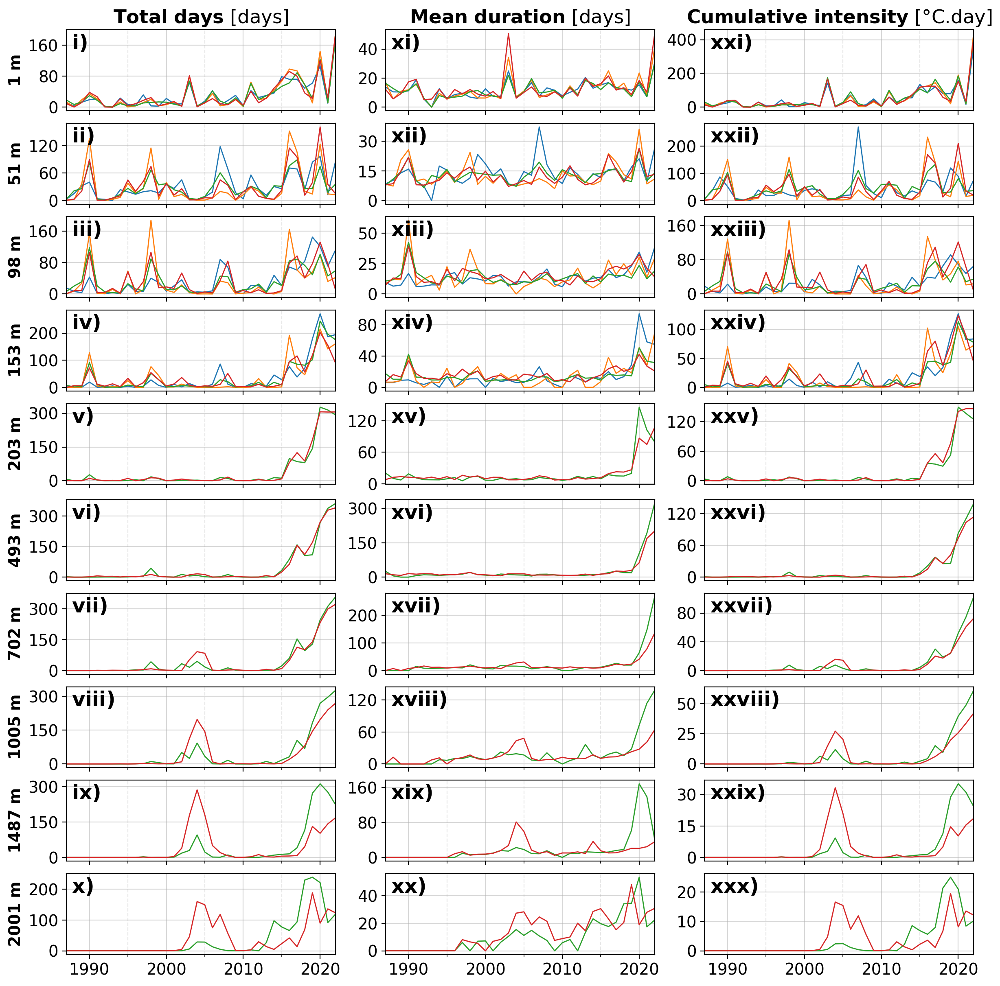

Making figure of 2400x2400px


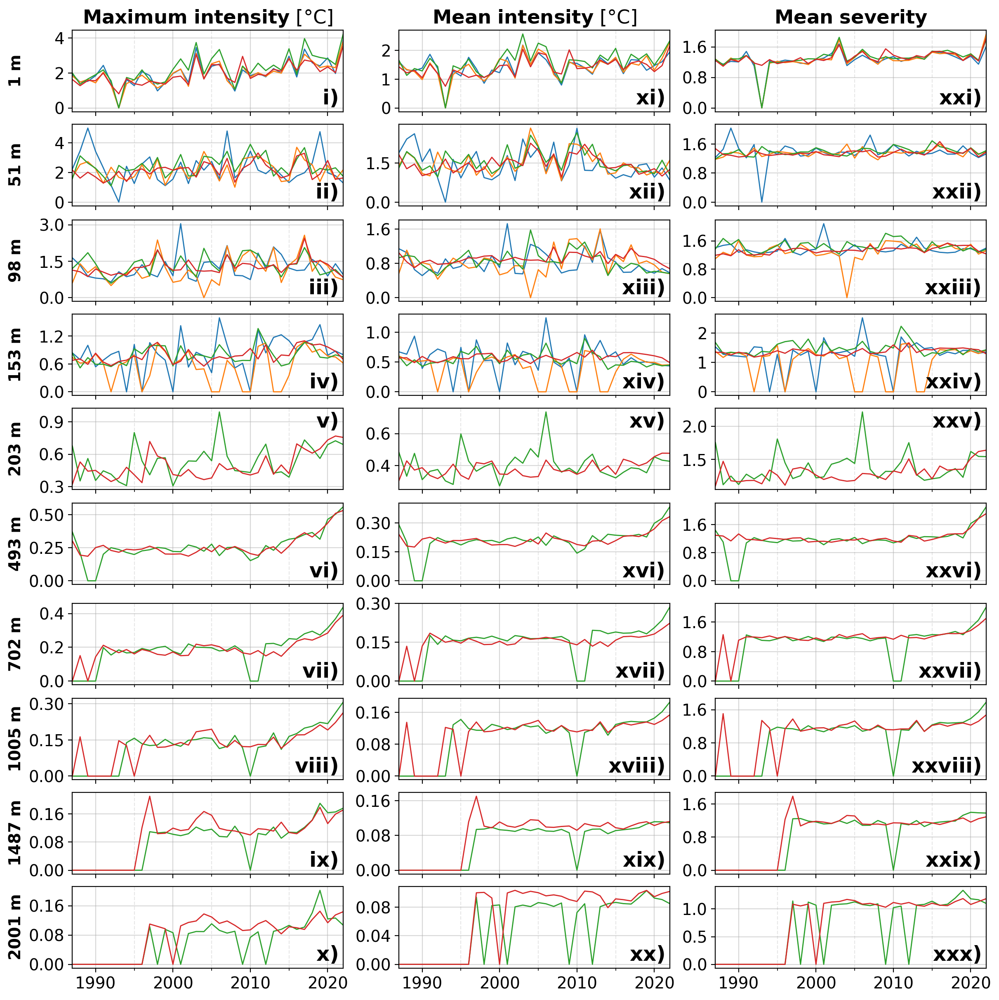

In [ ]:
# Generic one

from pyscripts.basic_plotter import plot_timeserie, subplot
from pyscripts.utils import apply_regional_mask

from roman import toRoman

regions = [
    "continental_coast",
    "balearic_coast",
    "balearic_sea_deep",
    "west_algerian_deep",
]
depths = [0, 50, 100, 150, 200, 500, 700, 1000, 1500, 2000,]

names = {
    "total_days":           r"$\bf{Total  \ days}$ [days]",
    "duration":             r"$\bf{Mean \ duration}$ [days]",
    "total_icum":           r"$\bf{Cumulative \ intensity}$ [°C.day]",
    "intensity_max_max":    r"$\bf{Maximum \ intensity}$ [°C]",
    "intensity_mean_byday": r"$\bf{Mean \ intensity}$ [°C]",
    "severity_mean_byday": r"$\bf{Mean \ severity}$",
}

vlims = {
    'total_days': (0, 366),
    'duration': (0, 300),
    'total_icum': (0, 500),
    'intensity_max_max': (0, 6),
    'intensity_mean_byday': (0, 2.6),
    'severity_mean_byday': (0, 2.6),
}

regions_ds = {}

for region in regions:
    regions_ds[region] = apply_regional_mask(ds_mhws_medrea, region, ds_bathy_medrea)

for i, depth in enumerate(depths):
    depths[i] = ds_mhws_medrea.sel(depth=depth, method='nearest').depth.item()


for stats in [[
    'total_days',
    'duration',
    'total_icum',
],[
    'intensity_max_max',
    'intensity_mean_byday',
    'severity_mean_byday',
]]:
    ncols = len(stats)
    nrows = len(depths)
    
    subplots_settings = []

    for iss, stat in enumerate(stats):
        for id, depth in enumerate(depths):
            col = iss
            row = id
            
            if stat in ['intensity_max_max', 'intensity_mean_byday', 'severity_mean_byday']:
                subplot_label_ha = 'right'

                if depth > 190 and depth < 210:
                    subplot_label_va = 'top'
                else:
                    subplot_label_va = 'bottom'
            
            else:
                subplot_label_ha = 'left'
                subplot_label_va = 'top'

            subplots_settings.append(dict(
                pos = row * ncols + col + 1,
                func = plot_timeserie,
                vars = {
                    opts.region_shortname[region]:
                        regions_ds[region][stat].sel(depth=depth).mean(dim=["lon","lat"], keep_attrs=True)
                    
                    for region in (
                        regions[2:]
                        if (isinstance(depth, float) and depth > 200)
                        else
                            regions
                    )
                },
                times = regions_ds[regions[0]].year,
                colors = {
                    "Continental coast": 'C0',
                    "Balearic Islands coast": 'C1',
                    "Balearic Sea deep": 'C2',
                    "West Algerian Basin deep": 'C3',
                },

                nans_to_zero=True,

                title = names[stat] if row == 0 else None,
                ylabel = fr"$\bf{{{depth:.0f} \ m}}$" if col == 0 else None,
                legend=False,

                xticks=(10,),
                xticks_minor=2,
                yticks=3,

                bottom_labels = (row == nrows-1),

                texts = [dict(
                    x=(0.02-0.98) * (subplot_label_ha == 'left') + 0.98,
                    y=(0.04-0.96) * (subplot_label_va == 'bottom') + 0.96,
                    s=utils.bold(toRoman(row + nrows*col + 1).lower() + ')'),
                    ha=subplot_label_ha,
                    va=subplot_label_va,
                    fontsize=18
                )]
            ))

    fig = subplot(
        nrows, ncols,
        subplots_settings,

        figsize = (12, 12),
        figdpi = 200,
        fig_fontsize = 14,

        show_plots = True,
    )

## Figure 8

Making figure of 2400x3040.0px


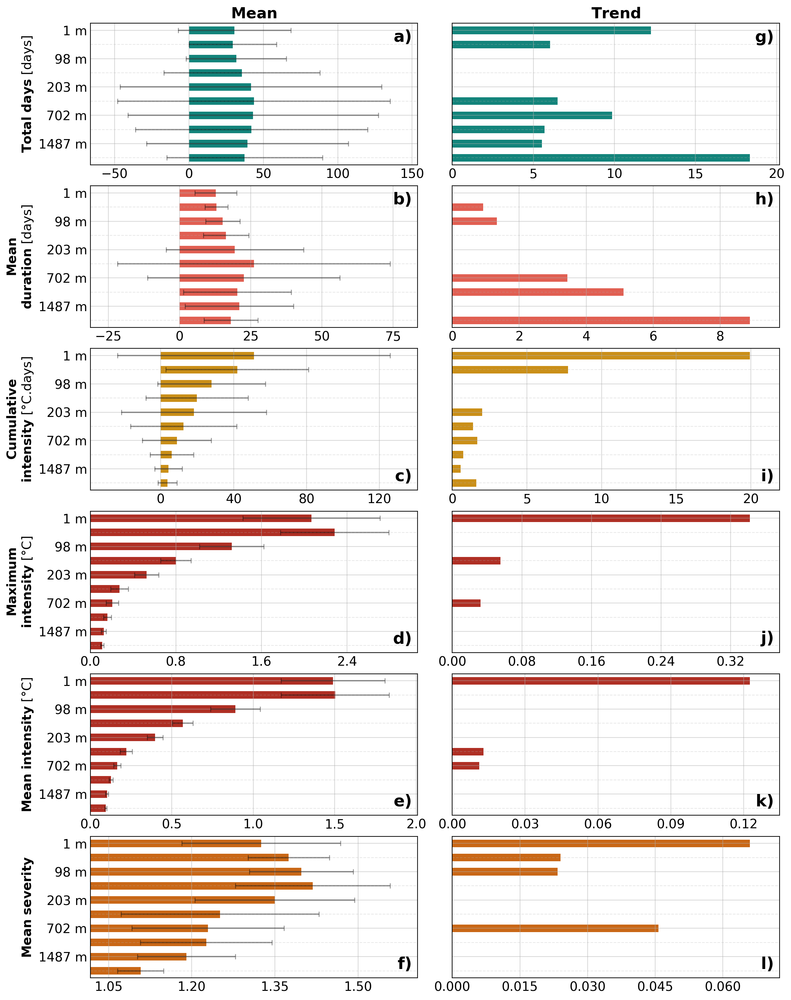

In [ ]:
from pyscripts.basic_plotter import plot_bars, subplot
from pyscripts.utils import apply_regional_mask

# USER INPUT - Choose what to be displayed
columns = [
    'Mean',
    # '2022',
    'Trend'
]

# Names of stat with bolding
names = {
    "total_days":           r"$\bf{Total  \ days}$ [days]",
    "duration":             r"$\bf{Mean}$" "\n" r"$\bf{duration}$ [days]",
    "total_icum":           r"$\bf{Cumulative}$" "\n" r"$\bf{intensity}$ [°C.days]",
    "intensity_max_max":    r"$\bf{Maximum}$" "\n" r"$\bf{intensity}$ [°C]",
    "intensity_mean_byday": r"$\bf{Mean \ intensity}$ [°C]",
    "severity_mean_byday": r"$\bf{Mean \ severity}$",
}


# Subplot loop
for stats in [
    [
        'total_days',
        'duration',
        'total_icum',
    # ], [
        'intensity_max_max',
        'intensity_mean_byday',
        'severity_mean_byday',
    ]
]:
    subplots_settings = []

    ncols = len(columns)
    nrows = len(stats)

    for row, stat in enumerate(stats):
        for col, column in enumerate(columns):
            ds = ds_mhws_medrea

            std, hatchs = None, None

            if column == 'Mean':
                da = ds[stat].mean(dim=['lon', 'lat']).mean(dim='year')
                std = ds[stat].mean(dim=['lon', 'lat']).std(dim='year')

            elif column == '2022':
                da = ds[stat].sel(year=2022).mean(dim=['lon', 'lat'])

            elif column == 'Trend':
                da = ds[stat].mean(dim=['lon', 'lat'])

                def apply_mk_test(y):
                    if np.isnan(y).all():
                        return np.nan, np.nan, np.nan
                    
                    trend, h, p, z, tau, s, var_s, slope, intercept = mk.hamed_rao_modification_test(y, alpha=0.05)
                    
                    return h, p, slope

                h, p, slope = xr.apply_ufunc(
                    apply_mk_test,
                    da,
                    input_core_dims=[["year"]],
                    output_core_dims=[[], [], []],
                    vectorize=True,
                    dask="parallelized",
                    output_dtypes=[bool, float, float],
                )

                da = slope.where(h, 0)

                # Change from yearly trend to decadly trend
                da = da * 10

                unit = f"[{opts.mhws_stats_units[stat]} /decade]"
            
            colors = {
                "total_days":           "#13847b",
                "duration":             "#e15f52",
                "total_icum":           "#ca8f18",
                "intensity_max_max":    "#af2f24",
                'intensity_mean_byday': "#af2f24",
                'severity_mean_byday':  "#c96716",
            }

            subplots_settings.append(dict(
                pos = row*ncols + col + 1,
                func = plot_bars,
                depths = da.depth.values,
                vars = {'a': da},
                stds = {'a': std} if column == 'Mean' else None,
                colors = colors[stat],

                title = utils.bold(column) if row == 0 else None,
                ylabel = names[stat] if col == 0 else None,

                bars_pad = 0.5,
                # hatch = {'a': hatchs} if column == 'Trend' else None,

                xticks = 5,
                yticks = 2,

                left_labels = (col == 0),

                texts = [dict(
                    x=0.98,
                    y=(0.04-0.96) * [0,0,1,1,1,1,0,0,1,1,1,1][row + nrows*col] + 0.96,
                    s=utils.bold(subplot_label[row + nrows*col]),
                    ha='right',
                    va='bottom' if [0,0,1,1,1,1,0,0,1,1,1,1][row + nrows*col] else 'top',
                    fontsize=18
                )]
            ))

    # Creates figure settings, using user settings firstly, otherwise use default
    subplot(
        nrows, ncols,
        subplots_settings,
        
        figsize=(12,15.2),
        fig_fontsize = 14,
        figdpi=200,

        show_plots = True,
    )

## Figure 9&10

Making figure of 2400x2400px


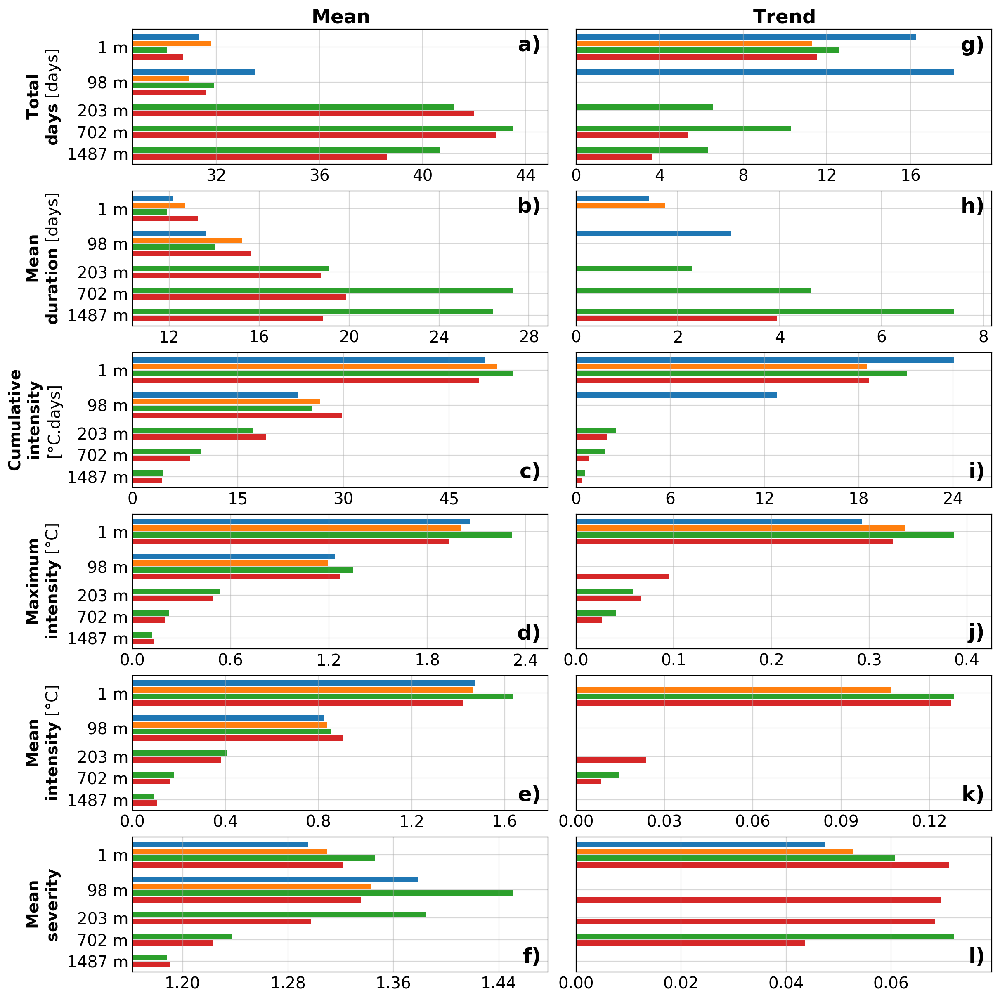

In [ ]:
from pyscripts.basic_plotter import plot_bars, subplot
from pyscripts.utils import apply_regional_mask

# USER INPUT - Choose what to be displayed
columns = [
    'Mean',
    # '2022',
    'Trend'
]
stats = [
    'total_days',
    'duration',
    'total_icum',
    'intensity_max_max',
    'intensity_mean_byday',
    'severity_mean_byday',
]
regions = [
    "continental_coast",
    "balearic_coast",
    "balearic_sea_deep",
    "west_algerian_deep",
]

# Names of stat with bolding
names = {
    "total_days":           r"$\bf{Total}$" "\n" r"$\bf{days}$ [days]",
    "duration":             r"$\bf{Mean}$" "\n" r"$\bf{duration}$ [days]",
    "total_icum":           r"$\bf{Cumulative}$" "\n" r"$\bf{intensity}$" "\n[°C.days]",
    "intensity_max_max":    r"$\bf{Maximum}$" "\n" r"$\bf{intensity}$ [°C]",
    "intensity_mean_byday": r"$\bf{Mean}$" "\n" r"$\bf{intensity}$ [°C]",
    "severity_mean_byday": r"$\bf{Mean}$" "\n" r"$\bf{severity}$",
}

subplot_label_pos = {
    "total_days":           [1, 1],
    "duration":             [1, 1],
    "total_icum":           [0, 0],
    "intensity_max_max":    [0, 0],
    "intensity_mean_byday": [0, 0],
    "severity_mean_byday":  [0, 0],
}


regions_ds = {}

for region in regions:
    regions_ds[region] = apply_regional_mask(ds_mhws_medrea, region, ds_bathy_medrea)

subplots_settings = []

ncols = len(columns)
nrows = len(stats)

for row, stat in enumerate(stats):
    for col, column in enumerate(columns):
        region_das = {}

        for region in regions:
            ds = regions_ds[region].sel(depth=[0, 100, 200, 700, 1500], method='nearest')

            if column == 'Mean':
                da = ds[stat].mean(dim=['lon', 'lat']).mean(dim='year')
            
            elif column == '2022':
                da = ds[stat].sel(year=2022).mean(dim=['lon', 'lat'])
     
            elif column == 'Trend':
                da = ds[stat].mean(dim=['lon', 'lat'])

                def apply_mk_test(y):
                    if np.isnan(y).all():
                        return np.nan, np.nan, np.nan
                    
                    trend, h, p, z, tau, s, var_s, slope, intercept = mk.hamed_rao_modification_test(y, alpha=0.05)
                    
                    return h, p, slope

                h, p, slope = xr.apply_ufunc(
                    apply_mk_test,
                    da,
                    input_core_dims=[["year"]],
                    output_core_dims=[[], [], []],
                    vectorize=True,
                    dask="parallelized",
                    output_dtypes=[bool, float, float],
                )

                da = slope.where(h, 0)

                # Change from yearly trend to decadly trend
                da = da * 10

                unit = f"[{opts.mhws_stats_units[stat]} /decade]"
            
            region_das[region] = da


        subplots_settings.append(dict(
            pos = row*ncols + col + 1,
            func = plot_bars,
            depths = da.depth.values,
            vars = region_das,

            title = utils.bold(column) if row == 0 else None,
            ylabel = names[stat] if col == 0 else None,

            # hatch = region_hatchs if column == 'Trend' else None,

            bars_pad = 1.2,
            
            xticks = 5,

            left_labels = (col == 0),

            texts = [dict(
                x=0.98,
                y=(0.96-0.04) * subplot_label_pos[stat][col] + 0.04,
                s=utils.bold(subplot_label[row + nrows*col]),
                ha='right',
                va='top' if subplot_label_pos[stat][col] else 'bottom',
                fontsize=18
            )]
        ))

# Creates figure settings, using user settings firstly, otherwise use default
subplot(
    nrows, ncols,
    subplots_settings,
    
    figsize=(12,12),
    fig_fontsize = 14,
    figdpi=200,

    show_plots = True,
)

## Figure 11

Making figure of 1000x2560.0px


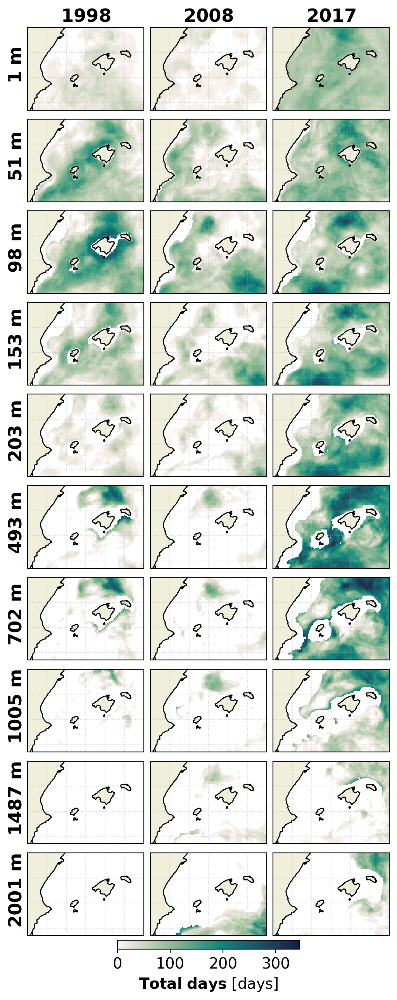

In [ ]:
# Map showing global overview of MHW stats over the years and layers

from pyscripts.basic_plotter import plot_map, subplot
from matplotlib.ticker import FuncFormatter
import roman

years = [1998,2008,2017]
depths = [1, 51, 98, 153, 203, 493, 702, 1005, 1487, 2001]
# years = [2017]
# depths = [1, 51]

for stat in [
    # 'total_scum'
    'total_days',
    # 'duration',
    # 'total_icum',
    # 'intensity_max_max',
    # 'intensity_mean_byday',
    # 'severity_mean_byday',
]:
    ncols = len(years)
    nrows = len(depths)
    title = "{stat}"

    subplots_settings = []

    for id, depth in enumerate(depths):
        for iy, year in enumerate(years):
            row = id
            col = iy

            ds = ds_mhws_medrea.sel(year=year, depth=depth, method='nearest')

            subplots_settings.append(dict(
                pos = row * ncols + col + 1,
                func = plot_map,
                lon = ds.lon,
                lat = ds.lat,
                data = ds[stat],

                # Parameter of text
                title = utils.bold(year) if row == 0 else None,
                ylabel = utils.bold(f"{depth:.0f} m") if col == 0 else None,

                zero_to_nan = True,
                ylabel_pad = -0.02,

                # vlim = (0, 366) if stat == "duration" else None,

                left_labels = False,
                bottom_labels = False,
                xticks = 6,
                yticks = 4,
            ))

    # Finally, plot the whole figure and subplots with the desired settings !
    subplot(
        nrows, ncols,
        subplots_settings,
        # pad_subplots = (0.001, 0.00001),
        # pad_subplots = (0.02, 0.2),
        
        # subplotsize = (6.9, 5),
        figsize = (5,12.8),
        fig_fontsize = 14,
        figdpi = 200,

        fig_cbar=True,
        fig_cmap = opts.mhws_stats_cmaps[stat],
        fig_cbar_unit = utils.bold(opts.mhws_stats_shortname[stat]) + f" [{opts.mhws_stats_units[stat]}]",
        fig_cbar_fraction = 0.01,
        fig_cbar_pad = 0.005,
        fig_cbar_orientation='horizontal',

        fig_cbar_ticks = 4,

        fig_is_a_map = True,

        # fig_title = title.format(stat=opts.mhws_stats_shortname[stat]),
        show_plots = True,
    )

## Figure A1&2

Making figure of 7128.0x1500px


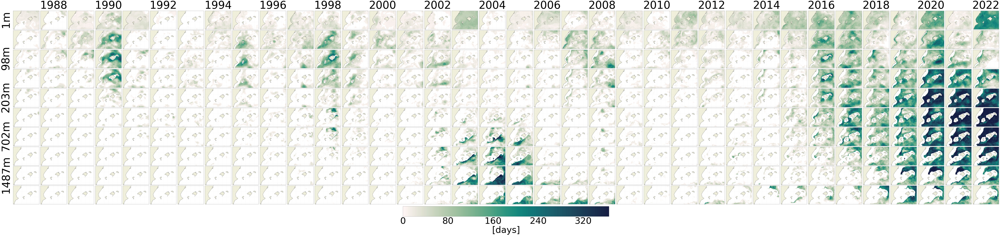

/LOCALDATA/ARTHURs_FILES/Codigos/pyscripts/basic_plotting.py:173: RuntimeWarning: All-NaN axis encountered
  fig_vmin = np.nanmin([np.nanmin(subplot_setting['data']) for subplot_setting in subplots_settings])
/LOCALDATA/ARTHURs_FILES/Codigos/pyscripts/basic_plotting.py:176: RuntimeWarning: All-NaN axis encountered
  fig_vmax = np.nanmax([np.nanmax(subplot_setting['data']) for subplot_setting in subplots_settings])


Making figure of 7128.0x1500px


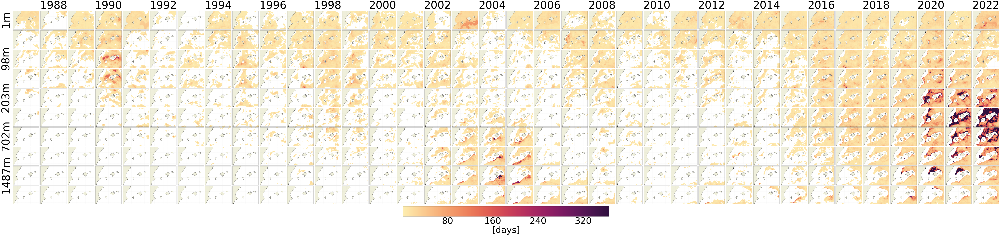

Making figure of 7128.0x1500px


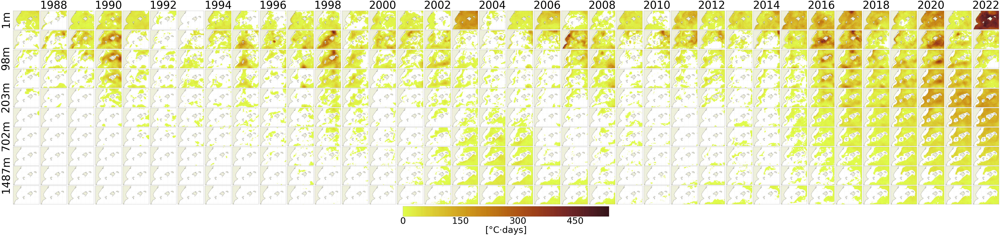

/LOCALDATA/ARTHURs_FILES/Codigos/pyscripts/basic_plotting.py:173: RuntimeWarning: All-NaN axis encountered
  fig_vmin = np.nanmin([np.nanmin(subplot_setting['data']) for subplot_setting in subplots_settings])
/LOCALDATA/ARTHURs_FILES/Codigos/pyscripts/basic_plotting.py:176: RuntimeWarning: All-NaN axis encountered
  fig_vmax = np.nanmax([np.nanmax(subplot_setting['data']) for subplot_setting in subplots_settings])


Making figure of 7128.0x1500px


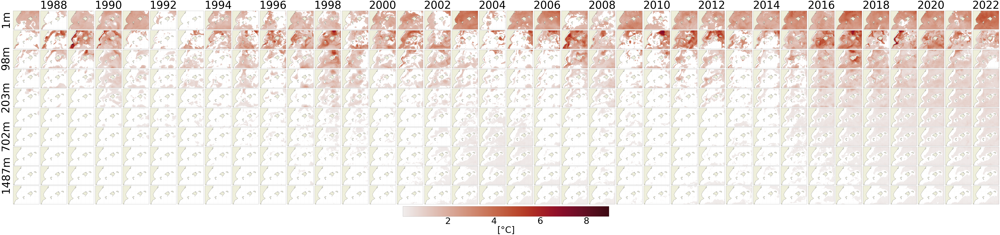

/LOCALDATA/ARTHURs_FILES/Codigos/pyscripts/basic_plotting.py:173: RuntimeWarning: All-NaN axis encountered
  fig_vmin = np.nanmin([np.nanmin(subplot_setting['data']) for subplot_setting in subplots_settings])
/LOCALDATA/ARTHURs_FILES/Codigos/pyscripts/basic_plotting.py:176: RuntimeWarning: All-NaN axis encountered
  fig_vmax = np.nanmax([np.nanmax(subplot_setting['data']) for subplot_setting in subplots_settings])


Making figure of 7128.0x1500px


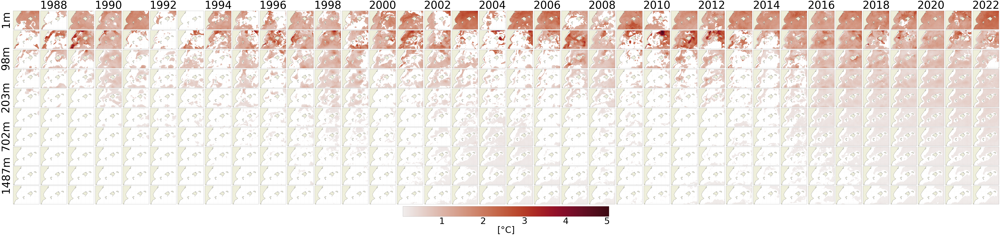

/LOCALDATA/ARTHURs_FILES/Codigos/pyscripts/basic_plotting.py:173: RuntimeWarning: All-NaN axis encountered
  fig_vmin = np.nanmin([np.nanmin(subplot_setting['data']) for subplot_setting in subplots_settings])
/LOCALDATA/ARTHURs_FILES/Codigos/pyscripts/basic_plotting.py:176: RuntimeWarning: All-NaN axis encountered
  fig_vmax = np.nanmax([np.nanmax(subplot_setting['data']) for subplot_setting in subplots_settings])


Making figure of 7128.0x1500px


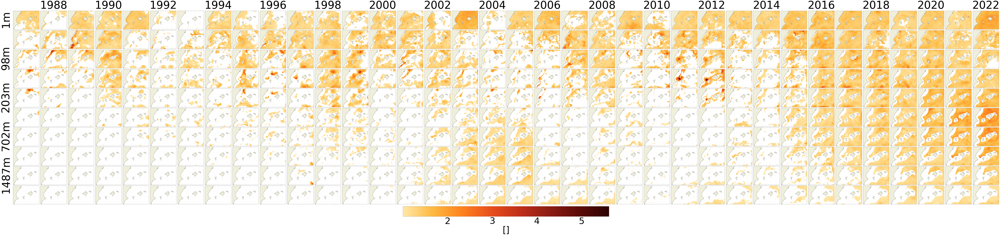

In [ ]:
# Map showing global overview of MHW stats over the years and layers

from pyscripts.basic_plotter import plot_map, subplot
from matplotlib.ticker import FuncFormatter
import roman

years = range(1987, 2023)
depths = [1, 51, 98, 153, 203, 493, 702, 1005, 1487, 2001]
# years = [2017]
# depths = [1, 51]

# ds = ds.compute()

for stat in [
    'total_days',
    'duration',
    'total_icum',
    'intensity_max_max',
    'intensity_mean_byday',
    'severity_mean_byday',
]:
    ncols = len(years)
    nrows = len(depths)
    title = "{stat}"

    subplots_settings = []

    for id, depth in enumerate(depths):
        for iy, year in enumerate(years):
            row = id
            col = iy

            ds = ds_mhws_medrea.sel(year=year, depth=depth, method='nearest')

            subplots_settings.append(dict(
                pos = row * ncols + col + 1,
                func = plot_map,
                lon = ds.lon,
                lat = ds.lat,
                data = ds[stat],

                # Parameter of text
                title = year if row == 0 and (year % 2 == 0) else None,
                ylabel = f"{depth:.0f}m" if col == 0 and row % 2 == 0 else None,
                ylabel_pad=-0.08,

                zero_to_nan = True,

                # vlim = (0, 366) if stat == "duration" else None,

                left_labels = False,
                bottom_labels = False,
                xticks = 6,
                yticks = 4,
            ))

    # Finally, plot the whole figure and subplots with the desired settings !
    subplot(
        nrows, ncols,
        subplots_settings,
        
        # figsize = (20,10),
        figdpi = 30,
        # figdpi = 5,
        # fig_fontsize = 20,
        # fig_fontsize = 40,
        fig_fontsize = 120,
        pad_subplots=(0.05,0.05),


        fig_cbar=True,
        fig_cmap = opts.mhws_stats_cmaps[stat],
        fig_cbar_unit = f"[{opts.mhws_stats_units[stat]}]",

        # fig_cbar_fraction = 0.006,
        # fig_cbar_pad = 0.003,
        # fig_cbar_orientation='vertical',
        # subplotsize = (6.9, 5),

        fig_cbar_fraction = 0.05,
        fig_cbar_pad = 0.01,
        fig_cbar_orientation='horizontal',
        subplotsize = (6.6, 5),

        fig_cbar_ticks = 5,
        fig_is_a_map = True,

        show_plots = True,
    )

## Figure A3

In [30]:
from pyscripts.load_save_dataset import load_mhws_dataset

ds_mhws_rep_mean = load_mhws_dataset(
    ds_type = 'all_events',
    dataset_used = 'medrea_mean',
    detrended = False,
    region = 'balears',
    clim_period = clim_period
)

Loaded MHWs dataset.


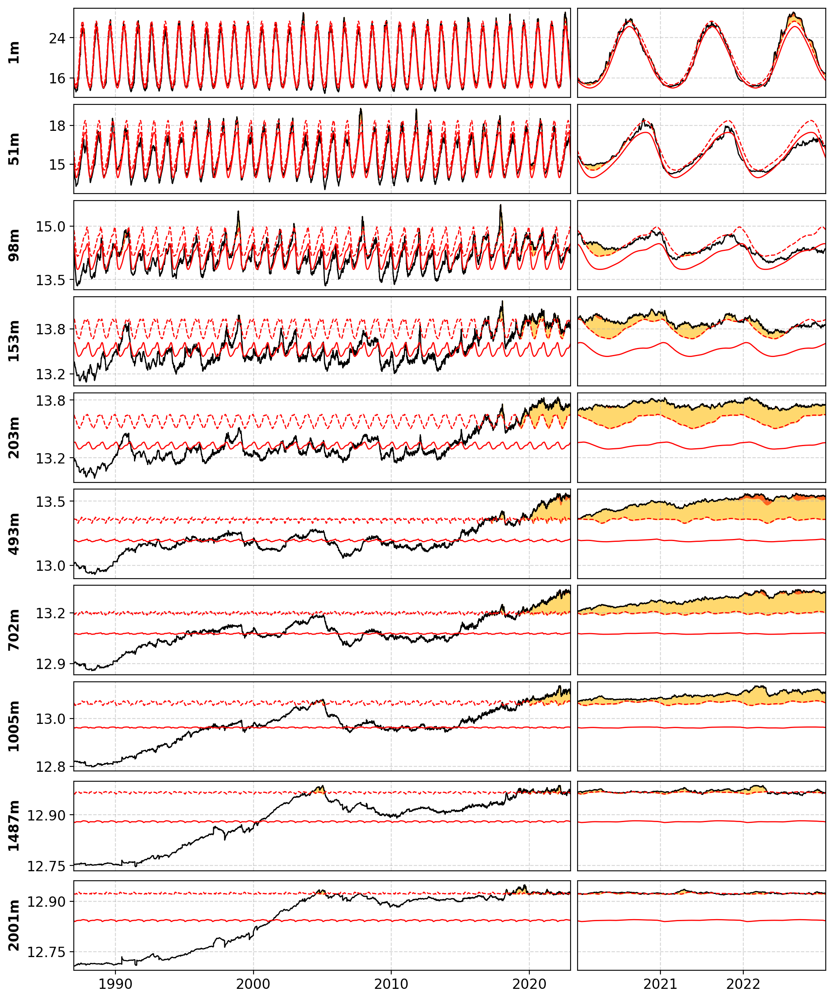

In [ ]:
from pyscripts.mhw_computer import get_mhw_ts_from_ds
from pyscripts.basic_plotter import get_locator_from_ticks
import matplotlib.pyplot as plt
import numpy as np

from datetime import date
from matplotlib.lines import Line2D
from matplotlib.patches import Patch


# depths = [1, 98, 493, 1005]
depths = ds_mhws_rep_mean.depth.values
date_ranges = [(0.5, 39.31), (0.5, 39.31)]

with plt.rc_context({'font.size': 12}):
    fig = plt.figure(figsize=(10, 12), dpi=200, constrained_layout=True)

    nrows = len(depths)
    ncols = len(date_ranges)+1

    for col, (t0, t1) in enumerate(date_ranges):
        for row, depth in enumerate(depths):
            time, mhws = get_mhw_ts_from_ds(ds_mhws_rep_mean, None, None, depth)

            if mhws == -1:
                continue

            index = (row*ncols + 1, row*ncols + 2) if col == 0 else row*ncols + col + 2

            ax = fig.add_subplot(nrows, ncols, index)

            ax.plot(time, mhws["clim_sst"], label="thetao", c='k', lw=1)
            ax.plot(time, mhws["clim_thresh"], label="1987-2021 p90", c='r', ls='--', lw=1)
            ax.plot(time, mhws["clim_seas"], label="1987-2021 mean", c='r', lw=1)

            mhws["clim_2thresh"] = mhws["clim_thresh"]*2 - mhws["clim_seas"]
            mhws["clim_3thresh"] = mhws["clim_thresh"]*3 - mhws["clim_seas"]*2

            for ev in range(mhws["n_events"]):
                id_slice = slice(mhws["index_start"][ev], mhws["index_end"][ev]+1)

                ax.fill_between(
                    time[id_slice],
                    mhws["clim_thresh"][id_slice],
                    np.minimum(
                        mhws["clim_sst"][id_slice],
                        mhws["clim_2thresh"][id_slice],
                    ),
                    color='#ffd86e',
                )
                
                strong_intensity = mhws["clim_sst"][id_slice]
                strong_intensity[np.where(mhws["clim_sst"][id_slice] < mhws["clim_2thresh"][id_slice])] = np.nan

                ax.fill_between(
                    time[id_slice],
                    mhws["clim_2thresh"][id_slice],
                    np.minimum(
                        strong_intensity,
                        mhws["clim_3thresh"][id_slice],
                    ),
                    color='#ff621f',
                )
                
                severe_intensity = mhws["clim_sst"][id_slice]
                severe_intensity[np.where(mhws["clim_sst"][id_slice] < mhws["clim_3thresh"][id_slice])] = np.nan

                ax.fill_between(
                    time[id_slice],
                    mhws["clim_3thresh"][id_slice],
                    severe_intensity,
                    color='#df391b',
                )

            ax.grid(True, ls='--', alpha=0.5)
            
            ax.yaxis.set_major_locator(get_locator_from_ticks(1))

            if col == 0:
                ax.set_ylabel(fr"$\bf{{{depth:.0f}m}}$")
            else:
                ax.tick_params(which='both', left=False, labelleft=False)
            
            fig.align_ylabels()

            if col == 1:
                ax.set_xlim(date(2020, 1, 1), date(2022, 12, 31))
                ax.set_xticks(
                    [date(2021, 1, 1), date(2022, 1, 1)],
                    ["2021", "2022"]
                )

            else:
                ax.set_xlim(date(1987, 1, 1), date(2022, 12, 31))
                ax.set_xticks(
                    [date(1990, 1, 1), date(2000, 1, 1), date(2010, 1, 1), date(2020, 1, 1)],
                    ["1990", "2000", "2010", "2020"]
                )
                
            if not row == nrows-1:
                ax.tick_params(which='both', bottom=False, labelbottom=False)

            ax.get_legend_handles_labels()

plt.show()

## Extra

### Get values

In [7]:
def get_stat(ds: xr.Dataset, stat, method=None, year=None, depth=None, region=None, ds_bathy=None):
    if 'depth' in ds.coords:
        if not depth is None:
            ds = ds.sel(depth=depth, method='nearest')
        
        else:
            return 'Depth must be specified'
    
    if region:
        if not ds_bathy:
            return "If selecting a region, ds_bathy must be provided"
        
        ds = apply_regional_mask(ds, region, ds_bathy)
    
    if method == 'mean':
        return ds[stat].mean(dim=['lon', 'lat']).mean(dim='year').item()
    
    elif method == 'std':
        return ds[stat].mean(dim=['lon', 'lat']).std(dim='year').item()
    
    elif method == 'trend':
        da = ds[stat].mean(dim=['lon', 'lat'])

        trend, h, p, z, tau, s, var_s, slope, intercept = mk.hamed_rao_modification_test(da.values, alpha=0.05)

        if h:
            return slope.item()*10
        else:
            return 'Not significant'
    
    elif year:
        return ds[stat].sel(year=year).mean(dim=['lon', 'lat']).item()
    
    else:
        return "Request couldn't get processed"

In [ ]:
ttdays = ds_mhws_medrea['total_days'].mean(dim=['lon', 'lat'])

In [53]:
# stats = ['intensity_mean_byday']
stats = opts.mhws_basic_stats

# depths = [1,51]
depths = [0, 50, 100, 150, 200, 500, 700, 1000, 1500, 2000]

for stat in stats:
    print()
    print(opts.mhws_stats_shortname[stat], ':')
    for region in ['CC', 'BIC', 'DBS', 'DWAR']:
        print(f"{region}: {get_stat(ds_mhws_rep, stat, 'trend', region=region, ds_bathy=ds_bathy_rep):.3f}")
    # for depth in depths:
        # get_stat(ds_mhws_medrea, stat, 'std', depth)
        # print(f"{depth:.0f}m: {get_stat(ds_mhws_medrea, stat, 'std', depth):.3f}")

        # if isinstance(get_stat(ds_mhws_medrea, stat, 'trend', depth), float):
        #     print(f"{get_stat(ds_mhws_medrea, stat, 'mean', depth)/get_stat(ds_mhws_medrea, stat, 'trend', depth):.2f}")


Total days :
CC: 10.173
BIC: 9.347
DBS: 8.743
DWAR: 7.309

Mean duration :
CC: 1.462
BIC: 1.536
DBS: 1.138
DWAR: 1.229

Cumulative intensity :
CC: 16.182
BIC: 15.449
DBS: 15.118
DWAR: 13.110

Maximum intensity :
CC: 0.261
BIC: 0.358
DBS: 0.348
DWAR: 0.300

Mean intensity :
CC: 0.078
BIC: 0.151
DBS: 0.131
DWAR: 0.124

Mean severity :
CC: 0.041
BIC: 0.052
DBS: 0.045
DWAR: 0.056


In [ ]:
import numpy as np
import xarray as xr

ttdays = ds_mhws_medrea['total_days'].mean(dim=['lon', 'lat'])

def sort_years_by_value(values, years):
    # Trie les années selon les valeurs associées (par ordre décroissant)
    return years[np.argsort(values)[::-1]]

# Appliquer sur chaque profondeur
sorted_years_all_depths = xr.apply_ufunc(
    sort_years_by_value,
    ttdays.transpose('depth', 'year'),  # met les dims dans le bon ordre
    ttdays['year'],
    input_core_dims=[['year'], ['year']],
    output_core_dims=[['year']],
    vectorize=True,
    dask='parallelized',
    output_dtypes=[int]
)

# Assigne les coordonnées pour bien identifier les profondeurs
sorted_years_all_depths = xr.DataArray(
    sorted_years_all_depths,
    dims=['depth', 'year'],
    coords={'depth': ttdays.depth, 'year': ttdays.year}
)


In [59]:
tt = ds_mhws_rep['total_days'].mean(dim=['lon', 'lat'])
tt = tt['year'].values[np.argsort(tt)[::-1]]
tt

array([2022, 2023, 2016, 2017, 2003, 2020, 2015, 2011, 2018, 2014, 2006,
       2013, 1990, 1997, 2009, 1989, 2012, 1991, 2007, 2021, 2019, 1998,
       1999, 2001, 1987, 2005, 1994, 2000, 2010, 1985, 1996, 2008, 1988,
       2002, 1995, 1986, 2004, 1983, 1982, 1992, 1993, 1984])

In [ ]:
get_stat(ds_mhws_medrea, 'total_days', year=2020, depth=0)

121.82525390011517

In [69]:
get_stat(ds_mhws_rep, 'total_days', year=2020, depth=0)

57.63877405559516

### Extra timeseries with depth

Making figure of 2400x800px


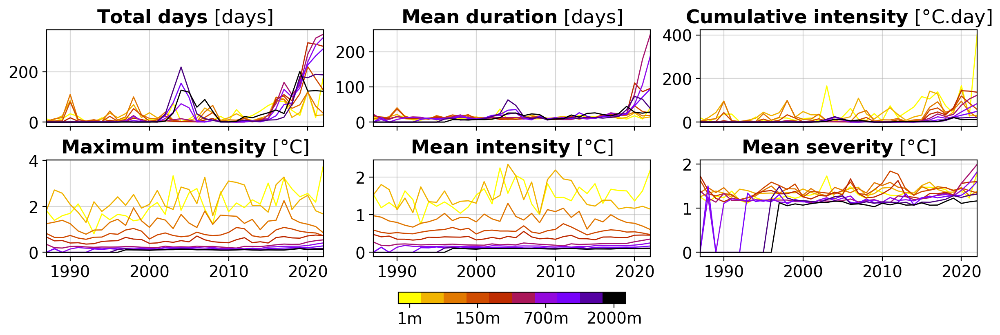

In [ ]:
# Generic one

from pyscripts.basic_plotter import plot_timeserie, subplot
import math


depths = [0, 50, 100, 150, 200, 500, 700, 1000, 1500, 2000,]
# stats = [
#     'total_days',
#     'duration',
#     'total_icum',
#     'intensity_max_max',
#     'intensity_mean_byday',
#     'severity_mean_byday',
# ]
stats = opts.mhws_stats
stats = [
    'total_days',
    'duration',
    'total_icum',
    'intensity_max_max',
    'intensity_mean_byday',
    'severity_mean_byday'
]

names = {
    "total_days":           r"$\bf{Total  \ days}$ [days]",
    "duration":             r"$\bf{Mean \ duration}$ [days]",
    "total_icum":           r"$\bf{Cumulative \ intensity}$ [°C.day]",
    "intensity_max_max":    r"$\bf{Maximum \ intensity}$ [°C]",
    "intensity_mean_byday": r"$\bf{Mean \ intensity}$ [°C]",
    "severity_mean_byday": r"$\bf{Mean \ severity}$ [°C]",
}
# names = opts.mhws_stats_shortname

vlims = {
    'total_days': (0, 366),
    'duration': (0, 300),
    'total_icum': (0, 500),
    'intensity_max_max': (0, 6),
    'intensity_mean_byday': (0, 2.6),
    'severity_mean_byday': (0, 2.6),
}

cmap = 'gnuplot_r'
base_cmap = plt.get_cmap(cmap)
base_colors = base_cmap(np.linspace(0, 1, len(depths)))
cmap = ListedColormap(base_colors)
# colors = cmaps(np.linspace(0, 1, len(depths)))

for i, depth in enumerate(depths):
    depths[i] = ds_mhws_medrea.sel(depth=depth, method='nearest').depth.item()



ncols = 3
nrows = math.ceil(len(stats) / ncols)

subplots_settings = []

for iss, stat in enumerate(stats):
    col = iss % ncols
    row = iss // ncols

    subplots_settings.append(dict(
        pos = row * ncols + col + 1,
        func = plot_timeserie,
        vars = {
            depth: ds_mhws_medrea[stat].sel(depth=depth).mean(dim=["lon","lat"], keep_attrs=True)
            for depth in depths
        },
        times = ds_mhws_medrea.year,
        colors = {
            depth: color
            for depth, color in zip(depths, colors)
        },
        nans_to_zero=True,

        title = names[stat],
        legend=False,
        
        bottom_labels = (row == nrows-1),
    ))

fig = subplot(
    nrows, ncols,
    subplots_settings,

    figsize = (12, 4),
    figdpi = 200,
    fig_fontsize = 14,

    fig_cbar=True,
    fig_cmap=cmap,
    fig_vmin=0,
    fig_vmax=2000,
    fig_cbar_pad=0.05,
    fig_cbar_fraction=0.05,
    # fig_cbar_unit='Depth',
    fig_cbar_ticks=[[100, 700, 1300, 1900], ["1m", "150m", "700m", "2000m"]],
    fig_cbar_orientation='horizontal',

    show_plots = True,
)

### Extra vertical profiles

Making figure of 2400x1200px


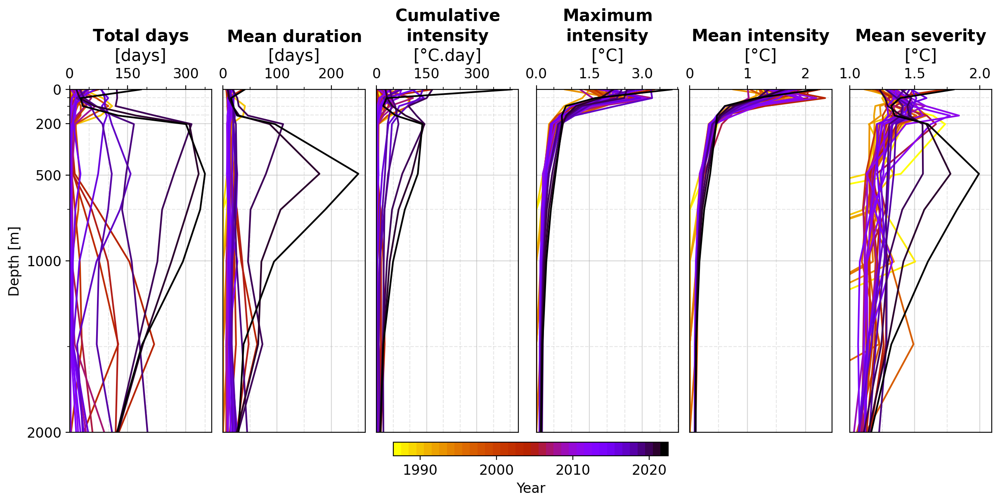

In [ ]:
# Generic one

from pyscripts.basic_plotter import plot_vertical_mean, subplot
from matplotlib.colors import ListedColormap

import math

stats = [
    'total_days',
    'duration',
    'total_icum',
    'intensity_max_max',
    'intensity_mean_byday',
    'severity_mean_byday',
]
years = range(1987, 2023)

names = {
    "total_days":           r"$\bf{Total  \ days}$" + "\n[days]",
    "duration":             r"$\bf{Mean \ duration}$" + "\n[days]",
    "total_icum":           r"$\bf{Cumulative}$" "\n" r"$\bf{intensity}$" + "\n[°C.day]",
    "intensity_max_max":    r"$\bf{Maximum}$" "\n" r"$\bf{intensity}$" + "\n[°C]",
    "intensity_mean_byday": r"$\bf{Mean \ intensity}$" + "\n[°C]",
    "severity_mean_byday": r"$\bf{Mean \ severity}$" + "\n[°C]",
}

ncols = 6
nrows = math.ceil(len(stats) / ncols)

xticks = [3, 3, 3, 3, 3, (.5,)]
xticks_minors = [3, 2, 3, 3, 2, 2]

subplots_settings = []

cmap = 'gnuplot_r'
base_cmap = plt.get_cmap(cmap)

# Extract the 20 original colors
base_colors = base_cmap(np.linspace(0, 1, 36))

# colors_36 = generate_36_colors(base_colors)
cmap = ListedColormap(base_colors)

for id, stat in enumerate(stats):
    col = id % ncols
    row = id // ncols

    # cmaps = plt.get_cmap(opts.mhws_stats_cmaps[stat])
    cmaps = plt.get_cmap(cmap)
    colors = cmaps(np.linspace(0, 1, len(years)))

    vars = {}
    for year in years:
        if stat in ['total_icum', 'total_scum', 'total_days']:
            vars[year] = ds_mhws_medrea[stat].sel(year=year).mean(dim=["lat", "lon"], skipna=True)

        else:
            ds = ds_mhws_medrea[stat].where(ds_mhws_medrea[stat] != 0., np.nan)
            ds = ds.sel(year=year).mean(dim=["lat", "lon"], skipna=True)
            vars[year] = ds.where(ds != 0.)
            # vars[year] = ds.where(False)

    subplots_settings.append(dict(
        pos = row * ncols + col + 1,
        func = plot_vertical_mean,
        vars=vars,
        depths = ds_mhws_medrea.depth,
        colors = {
            year: color
            for year, color in zip(years, colors)
        },

        nans_to_zero=True,

        title = names[stat],
        # unit = opts.mhws_stats_units[stat],

        xlim = (1,None) if stat in ['severity_mean_byday'] else (0, None),
        ylim = (0,2000),

        yticks=[0,200,500,1000,2000],
        yticks_minor=[50,100,150,700,1500],
        xticks=xticks[id],
        xticks_minor=xticks_minors[id],

        left_labels = (col == 0),
        top_labels = True,
        bottom_labels = False,
    ))

fig = subplot(
    nrows, ncols,
    subplots_settings,
    # pad_subplots=(0.1, 0.1),

    figsize = (12, 6),
    figdpi = 200,
    fig_fontsize = 12,

    fig_cbar=True,
    fig_cmap=cmap,
    fig_vmin=1986.5,
    fig_vmax=2022.5,
    fig_cbar_fraction=0.04,
    fig_cbar_unit='Year',
    fig_cbar_ticks=(10.,),
    fig_cbar_orientation='horizontal',

    show_plots = True,
)

### Extra serial autocorrelation assessment

Making figure of 800x600px


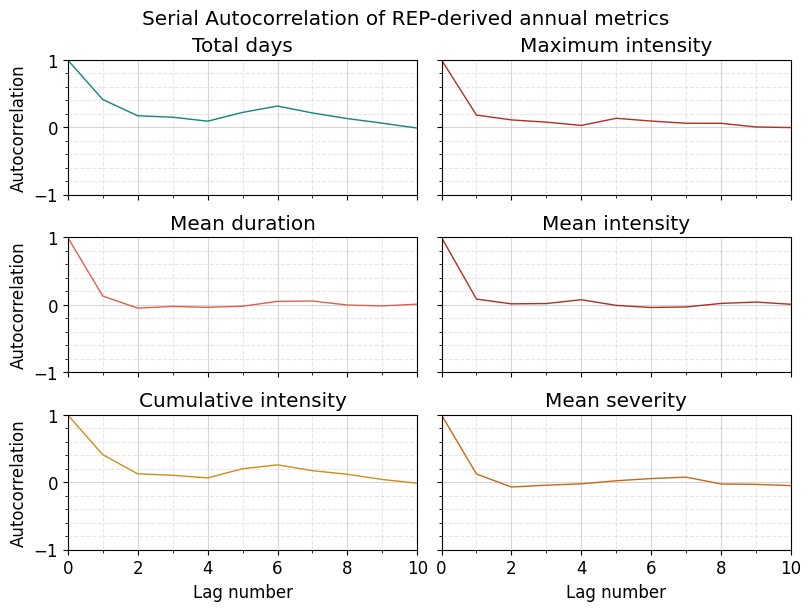

Making figure of 800x600px


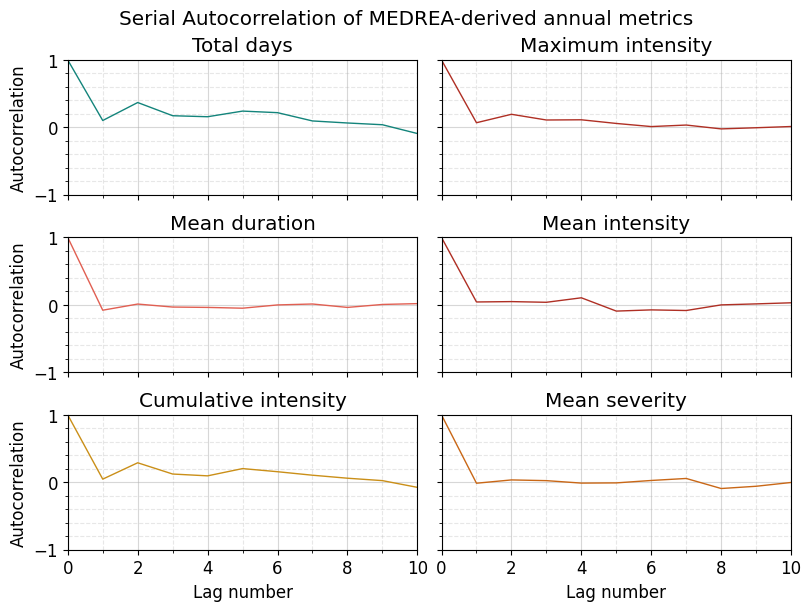

In [ ]:
import xarray as xr
import statsmodels.api as sm
from pyscripts.basic_plotter import plot_timeserie, subplot
import math

import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)

nlags = 10

def multi_lag_autocorr(x, nlags):
    return sm.tsa.acf(x, nlags=nlags, missing='conservative')

ncols = 2
nrows = math.ceil(len(opts.mhws_basic_stats) / ncols)

for model in ['REP', 'MEDREA']:
    ds_acf = xr.apply_ufunc(
        multi_lag_autocorr,
        ds_mhws_rep[opts.mhws_basic_stats] if model == 'REP' else ds_mhws_medrea[opts.mhws_basic_stats].sel(depth=0, method='nearest'),
        # nlags,
        input_core_dims=[["year"]],
        output_core_dims=[["lag"]],
        vectorize=True,
        dask="parallelized",
        output_dtypes=[float],
        kwargs={'nlags': nlags}
    )
    subplots_settings = []

    for i, stat in enumerate(opts.mhws_basic_stats):
        col = i // nrows
        row = i % nrows

        subplots_settings.append(dict(
            pos = row * ncols + col + 1,
            func = plot_timeserie,
            times = ds_acf.lag,
            vars = ds_acf[stat].mean(dim=['lon', 'lat']),
            colors = {
                "total_days":           "#13847b",
                "duration":             "#e15f52",
                "total_icum":           "#ca8f18",
                "intensity_max_max":    "#af2f24",
                'intensity_mean_byday': "#af2f24",
                'severity_mean_byday':  "#c96716",
            }[stat],

            title = opts.mhws_stats_shortname[stat],
            ylabel = "Autocorrelation" if col == 0 else None,
            xlabel = "Lag number" if row == nrows-1 else None,

            ylim=(-1,1),
            yticks=[-1,0,1],
            yticks_minor=(0.2,),
            xticks_minor=(1,),

            bottom_labels = row == nrows-1,
            left_labels = col == 0,
        ))

    subplot(
        nrows, ncols,
        subplots_settings,

        figsize = (8, 6),
        fig_fontsize = 12,

        fig_title = f"Serial Autocorrelation of {model}-derived annual metrics",

        show_plots = True,
        # save_plot = True,
        # save_path = f"ACF_{model}.png"
    )

In [63]:
from pyscripts.load_save_dataset import load_rep

ds = load_rep(lon_selector=slice(4.5, 5), lat_selector=slice(38, 38.5), ).chunk({'time': -1})
ds

Loaded REP dataset.


<xarray.Dataset> Size: 6MB
Dimensions:  (time: 15340, lat: 9, lon: 10)
Coordinates:
  * lat      (lat) float32 36B 38.05 38.1 38.15 38.2 38.25 38.3 38.35 38.4 38.45
  * lon      (lon) float32 40B 4.546 4.596 4.646 4.696 ... 4.896 4.946 4.996
  * time     (time) datetime64[ns] 123kB 1982-01-01 1982-01-02 ... 2023-12-31
Data variables:
    T        (time, lat, lon) float32 6MB dask.array<chunksize=(15340, 9, 10), meta=np.ndarray>
Attributes: (12/51)
    Conventions:                CF-1.4 
    title:                      Mediterranean Sea SST Analysis L4, Reprocesse...
    summary:                    [1982-2018] Daily gap-free maps (L4) at 0.05d...
    references:                 A. Pisano, B. Buongiorno Nardelli, C. Troncon...
    institution:                GOS
    history:                    Mon Jun 10 12:26:11 2024: ncrcat 198201010000...
    ...                         ...
    publisher_name:             CNR ISMAR GOS - CMEMS SST-TAC
    publisher_url:              http://marine.copernicus.eu/
    publisher_email:            servicedesk.cmems@mercator-ocean.eu, gsdk@isa...
    processing_level:           L4
    cdm_data_type:              grid
    NCO:                        netCDF Operators version 5.0.6 (Homepage = ht...

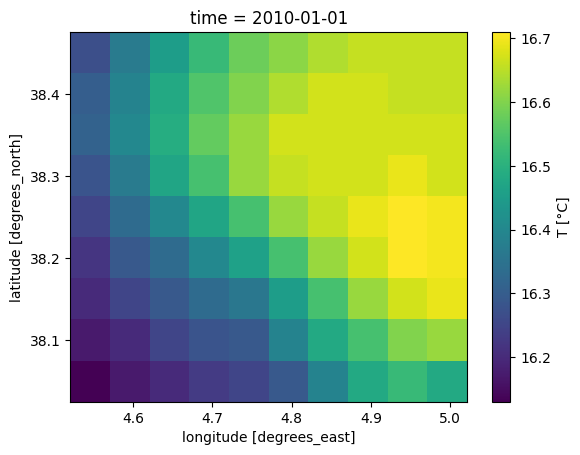

In [55]:
ds.T.isel(time=0).plot()
plt.show()

/tmp/ipykernel_17266/2640610868.py:17: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  ds_acf = xr.apply_ufunc(


Making figure of 800x600px


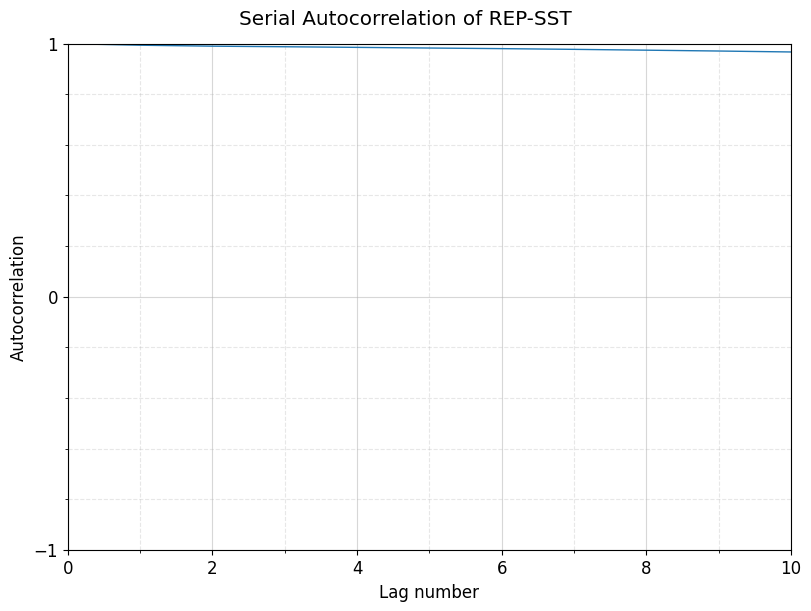

In [ ]:
import xarray as xr
import statsmodels.api as sm
from pyscripts.basic_plotter import plot_timeserie, subplot
import math

import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)

nlags = 10

def multi_lag_autocorr(x, nlags):
    return sm.tsa.acf(x, nlags=nlags, missing='conservative')

ncols = 1
nrows = 1

ds_acf = xr.apply_ufunc(
    multi_lag_autocorr,
    ds,
    # nlags,
    input_core_dims=[["time"]],
    output_core_dims=[["lag"]],
    vectorize=True,
    dask="parallelized",
    output_dtypes=[float],
    output_sizes={"lag": nlags+1},
    kwargs={'nlags': nlags}
)
subplots_settings = []

col = 0
row = 0

subplots_settings.append(dict(
    pos = row * ncols + col + 1,
    func = plot_timeserie,
    times = ds_acf.lag,
    vars = ds_acf.T.mean(dim=['lon', 'lat']),
    
    ylabel = "Autocorrelation" if col == 0 else None,
    xlabel = "Lag number" if row == nrows-1 else None,

    ylim=(-1,1),
    yticks=[-1,0,1],
    yticks_minor=(0.2,),
    xticks_minor=(1,),

    bottom_labels = row == nrows-1,
    left_labels = col == 0,
))

subplot(
    nrows, ncols,
    subplots_settings,

    figsize = (8, 6),
    fig_fontsize = 12,

    fig_title = f"Serial Autocorrelation of REP-SST",

    show_plots = True,
    save_plot = True,
    save_path = f"ACF_REP-SST.png"
)